# 🐕 End-to-end Multi-class Dog Breed Classification

This notebook builds an end-to-end multi-classimage classifier using TensorFlow 2.4.1 and TensorFlow hub


## 1. Problem
Can we identify the breed of a dog given the image of a dog.

I want to be able to tell what kind of breed a dog is with a photo when I'm on my laptop.

## 2. Data
The data we're using is from Kaggle's dog breed identification competition.

[Dataset here](https://www.kaggle.com/c/dog-breed-identification/data?select=test)



## 3. Evaluation
The evaluatioon is a file with prediction probabilities for each dog breed of each test image 

Excerpt from [here](https://www.kaggle.com/c/dog-breed-identification/overview/evaluation)

### Submission file
For each image in the test set, you must predict a probability for each of the different breeds. The file should contain a header and have the following format:

```
id,affenpinscher,afghan_hound,..,yorkshire_terrier
000621fb3cbb32d8935728e48679680e,0.0083,0.0,...,0.0083
etc.
```



## 4. Features

Some information about the data:
* We're dealing with images (unstructure data), so we should use deep learning and trasnfer learning
* There's a `sample_submission.csv' set up with the format stated above
* There are 120 dog breeds that are put in the  10,222 rows in the `labels.csv` file
* There are around 10,000+ images in the training set(these have labels)
* There are 10,000+ images in the test set (These have no labels, we want to predict them)

# Get our Workspace ready
* Import TensorFlow 2.x ✅
* Import TensorFlow Hub✅
* Make sure we're using a GPU✅  (checked and we weren't using one)

In [ ]:
# Imports
import pandas as pd
import numpy as np
import tensorflow as tfl
import tensorflow_hub as tfhub
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier

In [ ]:
print(tfl.__version__)
print(tfhub.__version__)

# Check for GPU availability

print('GPU', 'available (YES! OOO!)' if tfl.config.list_physical_devices('GPU') else 'not available')

2.5.0
0.12.0
GPU available (YES! OOO!)


In [ ]:
# ! unzip '/content/drive/MyDrive/Dog-Vision/dog-breed-identification' -d '/content/drive/MyDrive/Dog Vision/dogproj'

## Getting our data ready (turning it into tensors)

With all machine learning models, our data has to be turned into numerical format. So that's what we'll be doing first. Turning our images into Tensors(numerical representation)

In [ ]:
dog_labels = pd.read_csv('/content/drive/MyDrive/Dog-Vision/dogproj/labels.csv')
dog_labels.describe()

,id,breed
count,10222,10222
unique,10222,120
top,4873e3125122daa9d24ce1be0266bd39,scottish_deerhound
freq,1,126


In [ ]:
dog_labels.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


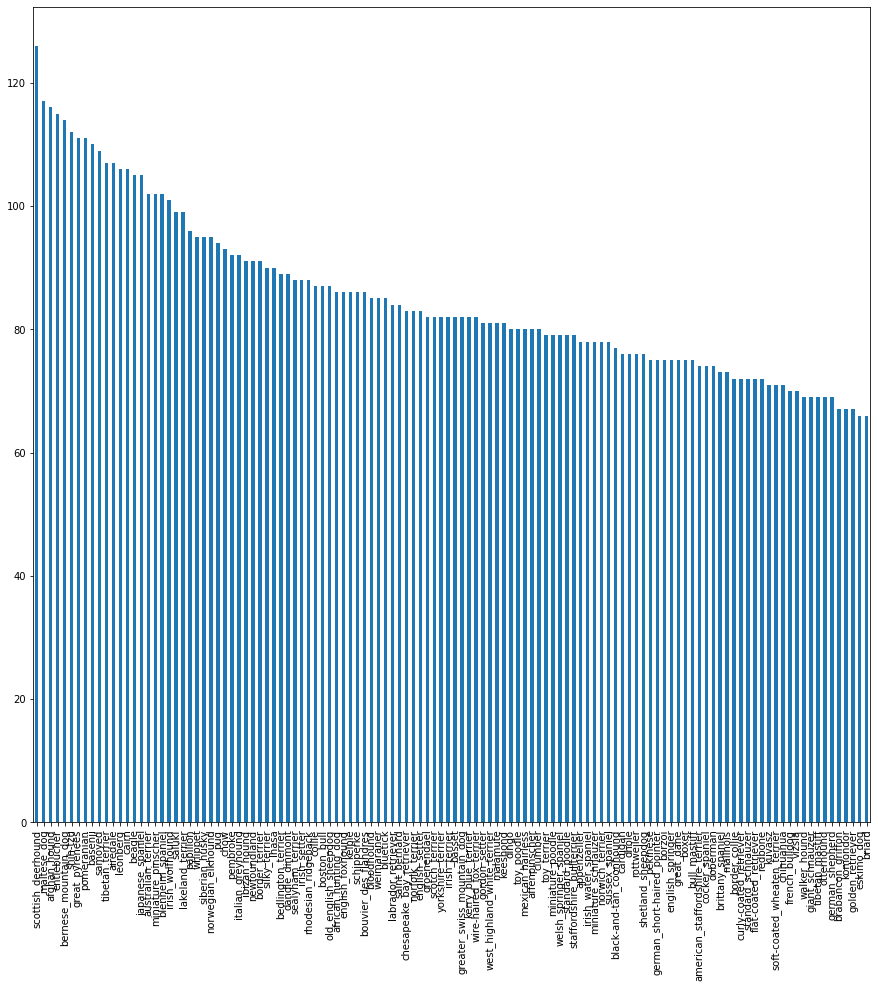

In [ ]:
# How many images are there per class( There are 120 classes here)
dog_labels['breed'].value_counts().plot.bar(figsize=(15, 15))

In [ ]:
print('Median : ', dog_labels['breed'].value_counts().median())
print('Mean : ', dog_labels['breed'].value_counts().mean())

Median :  82.0
Mean :  85.18333333333334


In [ ]:
dict(dog_labels['breed'].value_counts())

{'affenpinscher': 80,
 'afghan_hound': 116,
 'african_hunting_dog': 86,
 'airedale': 107,
 'american_staffordshire_terrier': 74,
 'appenzeller': 78,
 'australian_terrier': 102,
 'basenji': 110,
 'basset': 82,
 'beagle': 105,
 'bedlington_terrier': 89,
 'bernese_mountain_dog': 114,
 'black-and-tan_coonhound': 77,
 'blenheim_spaniel': 102,
 'bloodhound': 85,
 'bluetick': 85,
 'border_collie': 72,
 'border_terrier': 91,
 'borzoi': 75,
 'boston_bull': 87,
 'bouvier_des_flandres': 86,
 'boxer': 75,
 'brabancon_griffon': 67,
 'briard': 66,
 'brittany_spaniel': 73,
 'bull_mastiff': 75,
 'cairn': 106,
 'cardigan': 76,
 'chesapeake_bay_retriever': 83,
 'chihuahua': 71,
 'chow': 93,
 'clumber': 80,
 'cocker_spaniel': 74,
 'collie': 87,
 'curly-coated_retriever': 72,
 'dandie_dinmont': 89,
 'dhole': 76,
 'dingo': 80,
 'doberman': 74,
 'english_foxhound': 86,
 'english_setter': 83,
 'english_springer': 75,
 'entlebucher': 115,
 'eskimo_dog': 66,
 'flat-coated_retriever': 72,
 'french_bulldog': 70,

So here we are checking the amount of dog pictures in each class to check whether there is an imbalance.. The middle value is 82 and the mean is 85. I'd say having 100 images for each class is the most ideal situation so this isn't a bad place to start

[**More info here**](https://cloud.google.com/vision/automl/docs/prepare)

## 📷 Preparing/Viewing  our Images

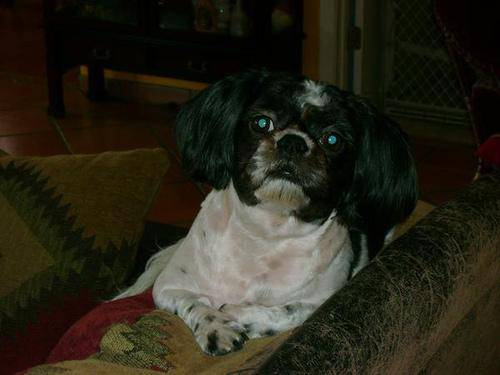

In [ ]:
# Let's view an image
from IPython.display import Image
Image('/content/drive/MyDrive/Dog-Vision/dogproj/train/06557d54077c5265ecdcd7273c9c38ca.jpg')

### Getting images and their labels

Let's get a list of all of our image file pathnames


In [ ]:
# Create pathname from Image ID's
filename = ['/content/drive/MyDrive/Dog-Vision/dogproj/train/' + fname + '.jpg' for fname in dog_labels['id']]
filename[:10]

['/content/drive/MyDrive/Dog-Vision/dogproj/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
 # Check whether number of filenames matches number of actual image files
 import os
 if len(os.listdir('/content/drive/MyDrive/Dog-Vision/dogproj/train/')) == len(filename):
  print('Filenames match actual amount of files, you can proceed')
 else:
  print('Files do not match, rerun the function')

Filenames match actual amount of files, you can proceed


In [ ]:
len(filename)

10222

Okay, now we've taken the file IDs and turned them into file paths to print with the `Image()` method. Now we need to convert our labels to numbers so we can process it 

In [ ]:
import numpy as np 
labels = np.array(dog_labels['breed']) # One way to do it
# labels = dog_labels['breed'].to_numpy() # Second way
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
len(labels)

10222

In [ ]:
# See if number of labels matches number of filenames
if len(labels) == len(filename):
  print('Great! No missing files. Keep Moving Forward G')
else:
  print('Oh crap, something went wrong')

Great! No missing files. Keep Moving Forward G


Okay thats good. We need to convert our labels into numbers, as they are only a string in an array but they need to be text. First let's find the unique values

In [ ]:
# Find the unique label values
unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
# Turn a single label into an array of booleans
print(labels[0])
bool_arr = labels[0] == unique_breeds
print(bool_arr)
print('Where uuique breeds is located', np.where(unique_breeds == 'boston_bull'))
print('Where the true value in the array is located :', np.where(bool_arr == 1))

boston_bull
[False False False False False False False False False False False False
 False False False False False False False  True False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False]
Where uuique breeds is located (array([19]),)
Where the true value in the array is located : (array([19]),)


In [ ]:
# Turn every label into a boolean array
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
# Example: Turning boolean array into integers
print(labels[0]) #Original array of labels
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # 0 is False, 1 is True. ! is where the sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
# Example 2 : Turning boolean array into integers
print(labels[1]) #Original array of labels
print(np.where(unique_breeds == labels[1])) # index where label occurs
print(boolean_labels[1].argmax()) # index where label occurs in boolean array
print(boolean_labels[1].astype(int)) # 0 is False, 1 is True. ! is where the sample label occurs

dingo
(array([37]),)
37
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


## Creating our own validation set

Since the dataset from Kaggle doesn't come with a validation set, we're going to create our own.

We're going to split our data with `test_train_split()` (Even though it says test and train, the functionality is that it splits the data up so it still provides as useful)

In [ ]:
from sklearn.model_selection import train_test_split
# Setup X & Y variables
x = filename # these are the features(What our data consists of)
y = boolean_labels # these are the labels (what categories the data is in)

Since we're working with 10,222 files, it's a good idea to train just a portion of them first to make sure it's working

This is a thing to note with machine learning projects :
>  Your main goal is usually to minimize the time between experiments, so you can learn what's necessary at a quicker pace

We're going to start off experimenting with ~1000 images and increase as needed

In [ ]:
# Set number of images to use for experimenting, (set our own parameter)
NUM_IMAGES = 1000 #@param {type: 'slider', min:1000, max:10000, step:1000}    


The convention is that variables in full capitals are hyperparameters you can set as a user

In [ ]:
# Let's split our data into train and validation sets

#Split them into training and validation of total size NUM_IMAGES
x_train, x_val, y_train, y_val = train_test_split(x[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.25,
                                                  random_state=24)

len(x_train), len(x_val), len(y_train), len(y_val)

(750, 250, 750, 250)

In [ ]:
#Let's have a gaze at the training data
x_train[:5], y_train[:5]

(['/content/drive/MyDrive/Dog-Vision/dogproj/train/0c3b282ecbed1ca9eb17de4cb1b6e326.jpg',
  '/content/drive/MyDrive/Dog-Vision/dogproj/train/0959e919604a931fc1ae379b7a75911a.jpg',
  '/content/drive/MyDrive/Dog-Vision/dogproj/train/1312009d41a9488bf5dc0af0289b0657.jpg',
  '/content/drive/MyDrive/Dog-Vision/dogproj/train/0f0f297dca75b5c780316a0f4169a950.jpg',
  '/content/drive/MyDrive/Dog-Vision/dogproj/train/00ca18751837cd6a22813f8e221f7819.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False,  True, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, F

 ## Preprocessing Images (Turning Images into Tensors(numbers))

 The easier way to convert the images into tensors is to create functions that convert the filepaths. This way we can just re-use the functions later on instead of just one cell

To preprocess our images into Tensors, we're going to write a function which does a few things:
1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable `Image`
3. Turn our `Image` (a jpg) into Tensors
4. Normalize our image (convert color channel values from 0-255 to 0-1
5. Resize the `image` to be a shape of (224, 224)
6. Return the modified image

Before we do, let's see what importing an image looks like:

 Remeber its important to feed the model images at the same shape on the data it was trained on 

In [ ]:
# Convert image to Numpy array
from matplotlib.pyplot import imread
image = imread(filename[24])
image.shape

(280, 200, 3)

The values above are height, width and then the color channel. In this case it's a RGB color channel. 
Each pixel in the image, is a combination of red, green & blue values. The values range between 0 and 255

In [ ]:
image

array([[[  0,   4,   0],
        [  0,   9,   3],
        [  1,  12,   6],
        ...,
        [  0,  13,   4],
        [ 12,  25,  16],
        [  0,   4,   0]],

       [[  0,   9,   3],
        [  7,  18,  12],
        [ 13,  24,  18],
        ...,
        [ 23,  36,  27],
        [ 34,  47,  38],
        [ 10,  23,  14]],

       [[  0,  10,   4],
        [  9,  20,  14],
        [ 17,  26,  21],
        ...,
        [ 17,  33,  23],
        [ 27,  43,  33],
        [  3,  16,   7]],

       ...,

       [[  0,   1,   0],
        [  5,   7,   2],
        [  9,  11,   6],
        ...,
        [ 71,  84,  77],
        [ 89, 104,  97],
        [ 29,  46,  38]],

       [[  6,   8,   3],
        [ 11,  13,   8],
        [ 13,  15,  10],
        ...,
        [120, 131, 127],
        [106, 118, 114],
        [ 15,  27,  23]],

       [[  1,   3,   0],
        [  6,   8,   5],
        [  6,   8,   5],
        ...,
        [ 21,  27,  27],
        [ 41,  50,  49],
        [  0,   5,   4]]

In [ ]:
# Turn image into a tensor
tfl.constant(image)

<tf.Tensor: shape=(280, 200, 3), dtype=uint8, numpy=
array([[[  0,   4,   0],
        [  0,   9,   3],
        [  1,  12,   6],
        ...,
        [  0,  13,   4],
        [ 12,  25,  16],
        [  0,   4,   0]],

       [[  0,   9,   3],
        [  7,  18,  12],
        [ 13,  24,  18],
        ...,
        [ 23,  36,  27],
        [ 34,  47,  38],
        [ 10,  23,  14]],

       [[  0,  10,   4],
        [  9,  20,  14],
        [ 17,  26,  21],
        ...,
        [ 17,  33,  23],
        [ 27,  43,  33],
        [  3,  16,   7]],

       ...,

       [[  0,   1,   0],
        [  5,   7,   2],
        [  9,  11,   6],
        ...,
        [ 71,  84,  77],
        [ 89, 104,  97],
        [ 29,  46,  38]],

       [[  6,   8,   3],
        [ 11,  13,   8],
        [ 13,  15,  10],
        ...,
        [120, 131, 127],
        [106, 118, 114],
        [ 15,  27,  23]],

       [[  1,   3,   0],
        [  6,   8,   5],
        [  6,   8,   5],
        ...,
        [ 21,  27,  2

In [ ]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing images
def preprocess_images(image_path, img_size=IMG_SIZE):
  '''
  Takes an image filepath and turns the image into a tensor
  '''
  #Read in an image file
  image = tfl.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with  3 color channels(Red, Green, Blue)
  image = tfl.image.decode_jpeg(image, channels=3)
  # Convert the color channel values from 0-255 to 0-1 values(Normalization)
  image = tfl.image.convert_image_dtype(image, tfl.float32)
  # Resize the image to our desired values (224, 224)
  image = tfl.image.resize(image, size = [IMG_SIZE, IMG_SIZE])

  return image
   

### Let's see what it does. 

Right here is where I executed each part of the function above to see what each part of it did

In [ ]:
image = tfl.io.read_file(filename[2])
image

<tf.Tensor: shape=(), dtype=string, numpy=b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\n\x07\x07\x08\x07\x06\n\x08\x08\x08\x0b\n\n\x0b\x0e\x18\x10\x0e\r\r\x0e\x1d\x15\x16\x11\x18#\x1f%$"\x1f"!&+7/&)4)!"0A149;>>>%.DIC<H7=>;\xff\xdb\x00C\x01\n\x0b\x0b\x0e\r\x0e\x1c\x10\x10\x1c;("(;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;\xff\xc0\x00\x11\x08\x01w\x01\xf4\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca

In [ ]:
image = tfl.io.read_file(filename[2])
image = tfl.image.decode_jpeg(image, channels=3)
image

<tf.Tensor: shape=(375, 500, 3), dtype=uint8, numpy=
array([[[ 97,  97,  89],
        [101, 101,  93],
        [108, 108, 100],
        ...,
        [  9,  11,  10],
        [  9,  11,  10],
        [  9,  11,  10]],

       [[ 99,  99,  91],
        [102, 102,  94],
        [107, 107,  99],
        ...,
        [ 17,  19,  18],
        [ 17,  19,  18],
        [ 17,  19,  18]],

       [[ 98,  97,  92],
        [ 99,  98,  93],
        [102, 101,  96],
        ...,
        [  6,   8,   7],
        [  6,   8,   7],
        [  6,   8,   7]],

       ...,

       [[192, 191, 186],
        [193, 192, 187],
        [195, 194, 189],
        ...,
        [118, 117, 113],
        [129, 128, 124],
        [127, 126, 122]],

       [[198, 197, 192],
        [199, 198, 193],
        [200, 199, 194],
        ...,
        [115, 115, 107],
        [107, 106, 101],
        [108, 108, 100]],

       [[199, 198, 193],
        [200, 199, 194],
        [202, 201, 196],
        ...,
        [ 95,  95,  8

In [ ]:
tfl.image.convert_image_dtype(image, tfl.float32)
# This is done because computing on floats instead of integers makes it more efficicent. 
# This is called normalization

<tf.Tensor: shape=(375, 500, 3), dtype=float32, numpy=
array([[[0.3803922 , 0.3803922 , 0.34901962],
        [0.39607847, 0.39607847, 0.3647059 ],
        [0.42352945, 0.42352945, 0.3921569 ],
        ...,
        [0.03529412, 0.04313726, 0.03921569],
        [0.03529412, 0.04313726, 0.03921569],
        [0.03529412, 0.04313726, 0.03921569]],

       [[0.38823533, 0.38823533, 0.35686275],
        [0.40000004, 0.40000004, 0.36862746],
        [0.41960788, 0.41960788, 0.38823533],
        ...,
        [0.06666667, 0.07450981, 0.07058824],
        [0.06666667, 0.07450981, 0.07058824],
        [0.06666667, 0.07450981, 0.07058824]],

       [[0.38431376, 0.3803922 , 0.36078432],
        [0.38823533, 0.38431376, 0.3647059 ],
        [0.40000004, 0.39607847, 0.37647063],
        ...,
        [0.02352941, 0.03137255, 0.02745098],
        [0.02352941, 0.03137255, 0.02745098],
        [0.02352941, 0.03137255, 0.02745098]],

       ...,

       [[0.75294125, 0.7490196 , 0.7294118 ],
        [0.75

##  Turning Data into Batches

We've converted our images into tensors but we still haven't finished getting our data ready. Tensor likes to see things in the form of a data batch, this is a Tensor containing an image example or piece of data example. (Remember, this is data agnostic we're just using images as our practical example 

It processes the data with a specified label and the data as a combined tensor so it can do it really fast. This could also be a mini-batch. (32 is generally the default batch size)

_Side Note_: Figure out things by googling 'Yann lecun or 'Jeremy Howard' and the concept you're trying to understand. Hear the opinions on a concept from people who make great contributions to the field of machine learning

Why turn our data into batches?

(We're just taking a small portion (32 images) and calculating the model those 32 images)
Let's say you're trying to process 10,000+ images in one go.. they all might not fit into memory.

That's why our batch size is usually about 32

In order to use Tensor flow effectively, we need our data in the form of Tensor tuples which look like this

`(image, label)`

In [ ]:
# Create a simple function to return a tuple of tensors
def get_image_label(image_path, label):
  '''
  Takes an image file path name and the associated label, processes the image and returns a tuple of (image, label)
  '''
  image = preprocess_images(image_path,)
  return image, label

In [ ]:
# Demo of the above
(preprocess_images(x[24]), tfl.constant(y[24])) 

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.        , 0.02205882, 0.0004902 ],
         [0.00205707, 0.03686975, 0.00378151],
         [0.00747549, 0.04903712, 0.01661415],
         ...,
         [0.02267136, 0.07724071, 0.03515386],
         [0.04925642, 0.09582529, 0.05936681],
         [0.00441176, 0.02794118, 0.00588235]],
 
        [[0.        , 0.03921569, 0.00539216],
         [0.02015932, 0.06678046, 0.03295694],
         [0.04519433, 0.08964461, 0.05761555],
         ...,
         [0.08460237, 0.14753135, 0.1039739 ],
         [0.10557685, 0.16096902, 0.12028274],
         [0.02205882, 0.07745098, 0.03676471]],
 
        [[0.        , 0.03921569, 0.00784314],
         [0.02633053, 0.06883754, 0.03746499],
         [0.05254727, 0.09568454, 0.06431198],
         ...,
         [0.08066337, 0.1504638 , 0.10379888],
         [0.08968931, 0.15733637, 0.11174814],
         [0.        , 0.06764706, 0.02205883]],
 
        ...,
 
        [[0.00490196, 0.02009804

Processing the data in this way where we create a tuple of tensors that consists of our images and labels is what we do with TensorFlow, regardless of whether we're processing text or images,
Now we're going to turn these Tensor tuples into batches. but there is a varied process for creating training batches, validation batches and test batches

Now we've got a way to turn our data into tuples of Tensors in the form: `(image, label),` let's make a function to turn all our data (x & y) into batches

In [ ]:
# Define the batch size, 32 is a good start
BATCH_SIZE=32

# Create a function to turn data into batches (for different batches)
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  '''
  Creates batches of data out of image (x) and labels (y) pairs
  Shuffles the data if it's training data but doesn't shuffle if it's validation data
  Also accepts test data as input(no labels)
  '''
  #If the data is a test dataset, we don't have any labels
  if test_data:
    print('Creating test data batches...')
    data = tfl.data.Dataset.from_tensor_slices(tfl.constant(x)) # only filepaths (no labels)
    #Basically saying "Pass me a dataset and I'll make tensors out of it "
    data_batch = data.map(preprocess_images).batch(BATCH_SIZE)
    return data_batch

  # If the data is a validation dataset, we dont need to shuffle it
  elif valid_data:
    print('Creating validation data batches...')
    data = tfl.data.Dataset.from_tensor_slices((tfl.constant(x), #filepaths  
                                               tfl.constant(y))) #labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print('Create training data batches...')
    # Turn filepaths and labels into Tensors
    data = tfl.data.Dataset.from_tensor_slices((tfl.constant(x),
                                                tfl.constant(y)))
    #Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create image label tuples
    # This also turns the image path into a preprocessed image
    data = data.map(get_image_label)
    data_batch = data.batch(BATCH_SIZE)
    return data_batch



In [ ]:
train_data = create_data_batches(x_train, y_train)
val_data = create_data_batches(x_val, y_val, valid_data=True)

Create training data batches...
Creating validation data batches...


In [ ]:
 train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visuzlizing Data Batches

In [ ]:
#Our data is now in batches, however these can be a little hard to interpret, let's visualize it
def show_25_images(images, labels):
  '''
  Displays a plot of 25 images and their labels from a data batch
  '''
  #Set up the figure
  plt.figure(figsize=(20, 20))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Displays an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the grid lines off
    plt.axis('off')

In [ ]:
train_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

because train data is in a batch format, we cant quite visualize it yet. We have to unbatch it first. We can do this with numpy

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
train_images, train_labels

(array([[[[0.05866597, 0.05866597, 0.02729342],
          [0.05204465, 0.04027994, 0.01282896],
          [0.04852067, 0.0361257 , 0.00898985],
          ...,
          [0.12055649, 0.0813408 , 0.03428197],
          [0.08412261, 0.05394061, 0.01020808],
          [0.10369924, 0.08016982, 0.03311099]],
 
         [[0.0474965 , 0.0474965 , 0.01612395],
          [0.04908089, 0.03731618, 0.0098652 ],
          [0.0541054 , 0.04171044, 0.01457458],
          ...,
          [0.11781345, 0.07859776, 0.03153893],
          [0.14251766, 0.11195697, 0.06898183],
          [0.13076995, 0.1047458 , 0.06267647]],
 
         [[0.03897934, 0.03897934, 0.00760679],
          [0.05038516, 0.03862045, 0.01116947],
          [0.05551323, 0.04311826, 0.01598241],
          ...,
          [0.11587316, 0.07665747, 0.02959864],
          [0.06877882, 0.03460349, 0.00250695],
          [0.06334997, 0.0354263 , 0.00429009]],
 
         ...,
 
         [[0.5827191 , 0.4376211 , 0.22948685],
          [0.57939

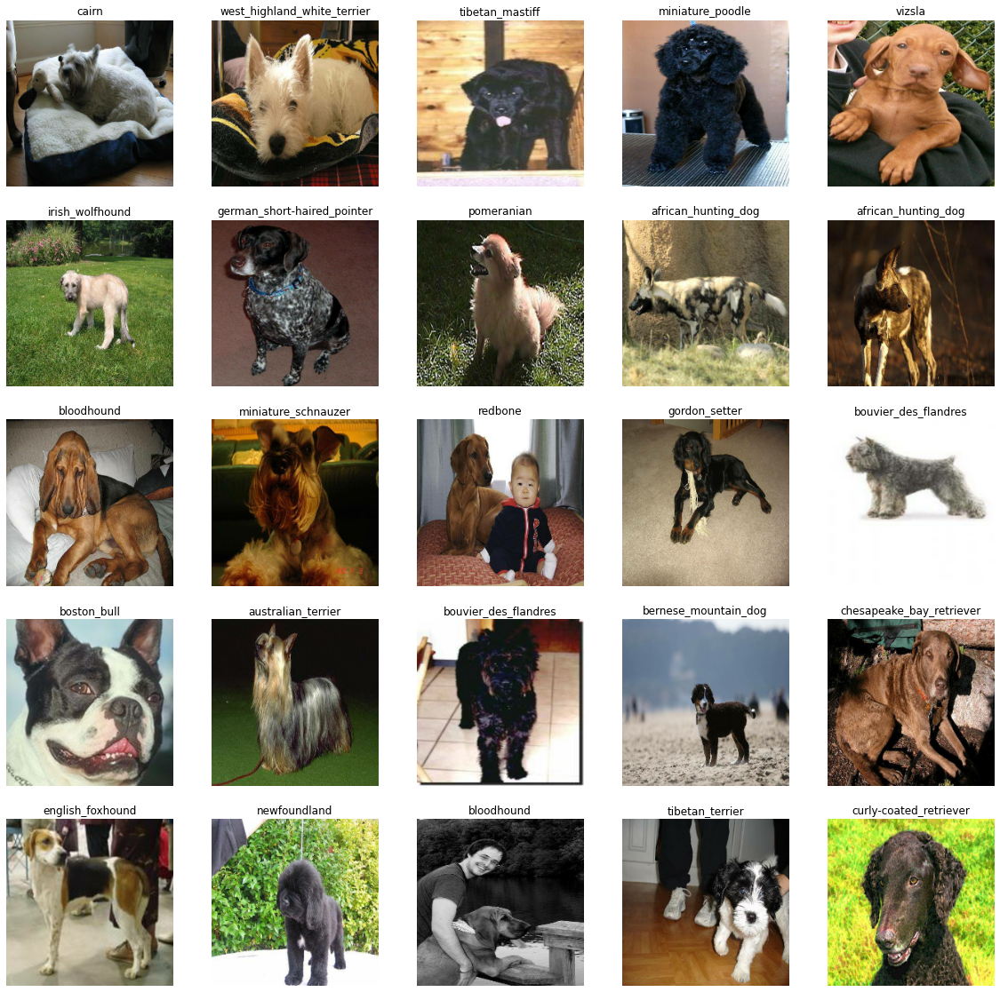

In [ ]:
# Now let's visualize the data in a training batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

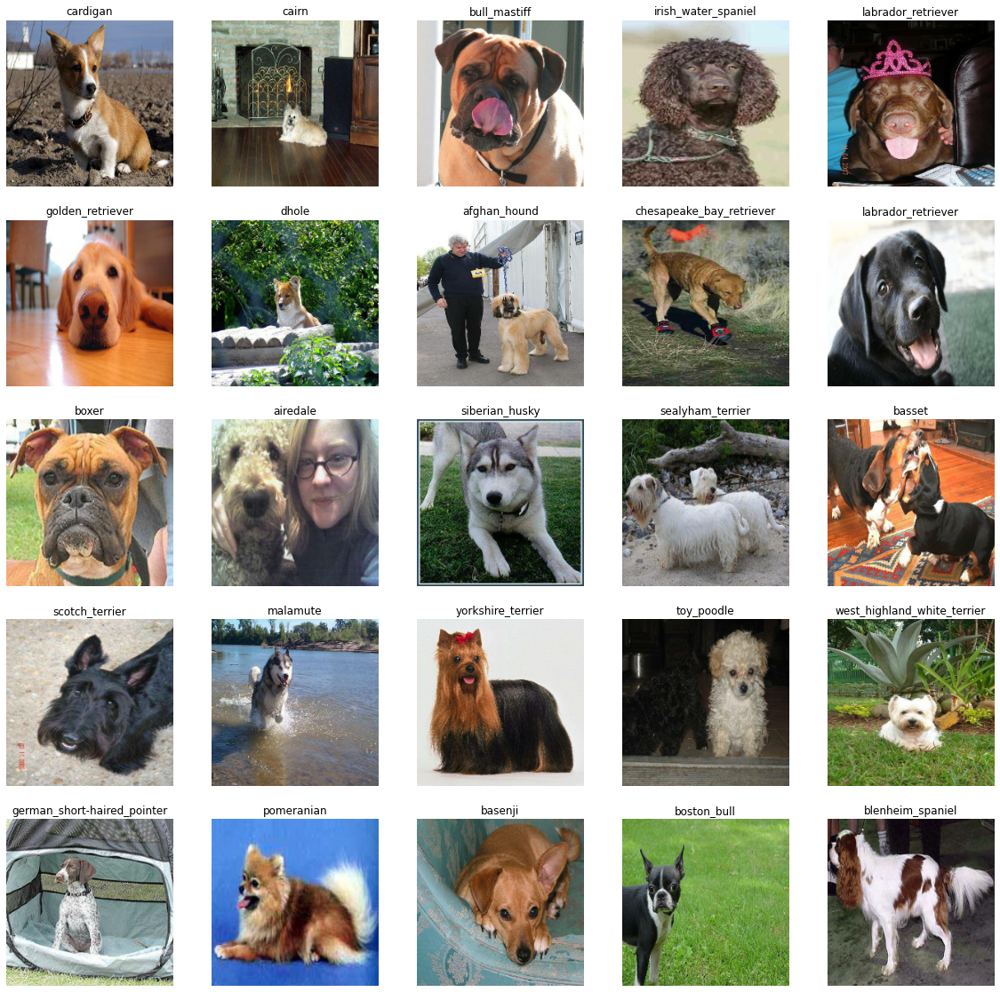

In [ ]:
# Now let's visualize our validation data
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building a model
There are a bunch of ways to do the one thing. 
Before we build a model,  there are a few things we need to define
* The input shape (our images shape, in the form of tensors) to our model
* The output shape (image labels, in the form of Tensors) of our model
* The URL of the model we want to use. (Taken from TensorFlow Hub) 

In [ ]:
# Set up input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

#Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)


 # Set up model URL from TensorFlow Hub
MODEL_URL = 'https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5'

  Now we've got our inputs, outputs and model ready to go. Let's put them together into a Keras deep learning model.

Let's create a function that:
* Takes the input shape, output shape and the model we've chosen as parameters
* Defines the layers in a Keras model in a sequential fashion (Do this first, then that)
* Compiles the model (says how it should be evaluated and improved)
* Builds the model (tells the model the input shape it'll be getting)
* Returns the model

In [ ]:
# Create a function which builds a Keras model
def create_model(input_shape = INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  '''
  Sets up model layers, compiles the model and builds it with the input shape

  '''
  
  print('Building model with: ', MODEL_URL)

  # Setup the model layers (Instantiating the model)
  model= tfl.keras.Sequential([
   tfhub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
   tfl.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation='softmax') #Layer 2 (output layer)
   
   ])
  
  # Compile the model (Putting it together)
  model.compile(
      loss=tfl.keras.losses.CategoricalCrossentropy(),
      optimizer=tfl.keras.optimizers.Adam(),
      metrics=['accuracy']
  )

  #Build the model
  model.build(INPUT_SHAPE)


  return model



In [ ]:
model = create_model()
model.summary()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating callbacks

Callbacks are helper functions a model can use during training  to do such things as save its progress , check its progress or stop training early  if a model stops improving. These help you inspect your model while it's training

We'll create two callbacks
* One for TensorBoard, which helps track our model's progress
* Another one for early stopping which prevents our model from training for too long 

## TensorBoard Callback
To setup a TensorBoard callback, we need to do 3 things:
1. Load the TensorBoard notebook extension ✅

2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function

3. Visualize our model's training logs with the `%tensorboard` magic function (we'll do this after model training)

In [ ]:
# Load TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
import datetime # To track the timing in our logs

# Create a function to build a TensorBoard callback
def create_tsboard_callback():
  logdir = os.path.join('drive/MyDrive/Dog-Vision/dogproj/logs',
                        # Make it so the logs get tracked whenever we run our experiment
                        
                        datetime.datetime.now().strftime('%Y%m%d-%H%M%S'))
  return tfl.keras.callbacks.TensorBoard(logdir)


### Early stopping callback

Early stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops imrpoving

In [ ]:
# Create early stopping callback 
early_stopping = tfl.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5)

## Training a model (on subset of data)

Our first model is only going to train on 1000 images, to make sure everything is working 

In [ ]:
NUM_EPOCHS = 100 #@param {type:'slider', min:10,  max:100, step:10}

Let's create a function which trains a model.
* Create a model using `create_model()`
* Setup a TensorBoard callback using `create_tsboard_callback()`
* Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for (NUM_EPOCHS) and the callbacks we'd like to use
* Return the model

In [ ]:
# Build  function to train and return a a trained model
def train_model():
  '''
  Trains a given model and returns the trained version 
  '''
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tsboard_callback()

  # Fit the model to the data, passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  # Return the fitted model
  return model


In [ ]:
# Fit the model to the data
model = train_model()
# Note: When training a model for the first time, the first epoch will ususally take the longest(This is with any large scale data)

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
24/24 [==============================] - 164s 7s/step - loss: 4.7054 - accuracy: 0.0880 - val_loss: 3.3276 - val_accuracy: 0.2960
Epoch 2/100
24/24 [==============================] - 38s 2s/step - loss: 1.6958 - accuracy: 0.6973 - val_loss: 2.1643 - val_accuracy: 0.5040
Epoch 3/100
24/24 [==============================] - 37s 2s/step - loss: 0.5890 - accuracy: 0.9387 - val_loss: 1.7323 - val_accuracy: 0.5920
Epoch 4/100
24/24 [==============================] - 37s 2s/step - loss: 0.2547 - accuracy: 0.9920 - val_loss: 1.5390 - val_accuracy: 0.6200
Epoch 5/100
24/24 [==============================] - 38s 2s/step - loss: 0.1434 - accuracy: 0.9987 - val_loss: 1.4870 - val_accuracy: 0.6200
Epoch 6/100
24/24 [==============================] - 38s 2s/step - loss: 0.0979 - accuracy: 1.0000 - val_loss: 1.4331 - val_accuracy: 0.6200
Epoch 7/100
24/24 [==============================] - 39s 2s

**Question** : It looks like our model is overfitting because it's performing far better on the training dataset than the validation dataset, what are some ways to prevent model overfitting in deep learning neural networks

**Note**: Overfitting as a problem to begin with is a good thing. It means our model is learning nicely

### Checking the TensorBoard Logs

The TensorBoard magic function (`%tensorboard`) will access the logs directory we created earlier and visualize its contents

In [ ]:
%tensorboard --logdir drive/MyDrive/Dog-Vision/dogproj/logs

Reusing TensorBoard on port 6006 (pid 307), started 0:25:13 ago. (Use '!kill 307' to kill it.)

<IPython.core.display.Javascript object>

## Making and evaluating predictions using a trained model

In [ ]:
val_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
predictions = model.predict(val_data, verbose=1)
predictions

8/8 [==============================] - 49s 1s/step


array([[8.7279805e-05, 9.5211644e-06, 6.0520233e-05, ..., 1.4823952e-05,
        2.1143450e-04, 1.3377766e-04],
       [2.3151726e-02, 3.9149443e-05, 2.2300830e-05, ..., 1.8170156e-05,
        2.7867718e-05, 2.8669375e-01],
       [6.8406091e-04, 2.3309863e-03, 3.4935831e-05, ..., 7.1717659e-04,
        1.4354470e-04, 6.4507092e-04],
       ...,
       [2.8788378e-03, 1.4346505e-03, 5.6305464e-05, ..., 1.4924351e-02,
        2.1262656e-04, 1.1988085e-03],
       [2.9040428e-03, 1.8379197e-04, 1.6968834e-05, ..., 1.7291150e-04,
        6.0548401e-04, 4.7835438e-03],
       [1.5455336e-04, 2.8997938e-06, 9.5825715e-05, ..., 5.3923664e-05,
        1.1564278e-04, 7.9384563e-04]], dtype=float32)

In [ ]:
predictions.shape

(250, 120)

In [ ]:
np.sum(predictions[0])

1.0

In [ ]:
len(y_val)

250

In [ ]:
predictions[0]

array([8.7279805e-05, 9.5211644e-06, 6.0520233e-05, 3.2188189e-05,
       2.9999774e-03, 3.0820228e-03, 1.2886829e-03, 1.0247625e-02,
       4.1188605e-04, 2.5093243e-03, 2.2738417e-05, 2.6474820e-04,
       8.5928659e-06, 2.7369356e-04, 6.4688702e-06, 8.3473287e-06,
       4.0727400e-04, 4.9173330e-05, 1.7265644e-05, 7.6502596e-04,
       1.9426907e-06, 1.8922001e-04, 1.2012372e-05, 1.9083005e-05,
       3.4607347e-04, 8.9507790e-05, 1.4564659e-03, 4.0007539e-02,
       1.4876295e-05, 2.6552640e-02, 6.4168438e-05, 6.2350489e-05,
       1.3825754e-04, 4.2032651e-04, 7.4920868e-06, 7.2575465e-05,
       4.8331742e-04, 5.2286913e-03, 1.9445155e-05, 2.5615166e-04,
       4.1448711e-05, 3.4930919e-05, 1.6120225e-04, 1.3207128e-04,
       6.9194823e-05, 1.2043912e-04, 2.1710064e-05, 3.8534286e-05,
       3.9872622e-05, 2.7547553e-04, 3.9733368e-06, 1.1698942e-05,
       2.4114117e-05, 1.4239730e-04, 3.8542389e-06, 1.3039276e-02,
       7.0309796e-04, 1.0609170e-04, 4.0195832e-06, 4.6855072e

In [ ]:
# First Prediction (Little index helper code)
lenard=0
# print(predictions[0])
print(f'Max value (probability of prediction) {np.max(predictions[lenard])}')
print(f'Sum : {np.sum(predictions[lenard])}')
print(f'Max index: {np.argmax(predictions[lenard])}')
print(f'Predicted label: {unique_breeds[np.argmax(predictions[lenard])]}')



Max value (probability of prediction) 0.8510468602180481
Sum : 1.0
Max index: 86
Predicted label: pembroke


In [ ]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  '''
  Turns an array of prediction probabilities into a label
  '''
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[24])
pred_label

'welsh_springer_spaniel'

Since our validation data is still in a Batch dataset, we'll have to "un-batch" it to make predictions on the validation images and then compare those predictions to the validation labels(truth_labels)

In [ ]:
images_ = []
labels_ = []

# Loop through unbatched data
for image, label in val_data.unbatch():
  images_.append(image)
  labels_.append(label)

In [ ]:
images_[0], labels_[0]

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.43604374, 0.5144751 , 0.65173   ],
         [0.43880516, 0.51723653, 0.6544914 ],
         [0.44323507, 0.5216664 , 0.6589213 ],
         ...,
         [0.5125088 , 0.59486175, 0.71643037],
         [0.5070991 , 0.589452  , 0.71102065],
         [0.5070991 , 0.589452  , 0.71102065]],
 
        [[0.44276175, 0.5211931 , 0.658448  ],
         [0.44596207, 0.5243935 , 0.6616484 ],
         [0.4504595 , 0.5288909 , 0.6661458 ],
         ...,
         [0.50615376, 0.5885067 , 0.7100753 ],
         [0.50980395, 0.5921569 , 0.7137255 ],
         [0.50980395, 0.5921569 , 0.7137255 ]],
 
        [[0.44555324, 0.5239846 , 0.6612395 ],
         [0.44705886, 0.5254902 , 0.6627451 ],
         [0.45129555, 0.5297269 , 0.6669818 ],
         ...,
         [0.4976366 , 0.5778274 , 0.7037203 ],
         [0.50764185, 0.5878326 , 0.7137255 ],
         [0.50764185, 0.5878326 , 0.7137255 ]],
 
        ...,
 
        [[0.5235311 , 0.47647226

In [ ]:
get_pred_label(labels_[32])

'pekinese'

In [ ]:
get_pred_label(predictions[32])

'pekinese'

In [ ]:
# Create a function to unbatch a different dataset
def unbatchify(data):
  '''
  Takes a batched dataset of (image, label) Tensors and returns separate arrays of images and labels
  '''
  images_func = []
  labels_func = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images_func.append(image)
    labels_func.append(unique_breeds[np.argmax(label)]) # labels_func.append(label) original code
  return images_func, labels_func

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)

In [ ]:
get_pred_label(val_labels[34])

'affenpinscher'

Now we've got ways to get:
* Prediction Labels
* Validation labels (truth labels)
* Validation images

Let's make some functions to make these all a bit more visual

We'll create a function which.
* Takes an array of prediction probabilities, an array of truth labels and an array of images and an integer
* Convert the prediction probabilities to a predicted label
* Plot the predicted label, it's predicted probabilitity, the truth label and the target image on a simple plot

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  '''
  View the prediction, ground truth and image for sample n
  '''
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image and remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the colour of the titile depending on if the prediction is right or wrong 
  if pred_label == true_label:
    color = 'green'
  else:
      color='red'

  # Change plot title to be predicted label , probability of prediction and truth label
  plt.title("{}, {:2.0f}%, {}".format(pred_label,
                                      np.max(pred_prob)*100, 
                                      true_label),
                                      color=color)


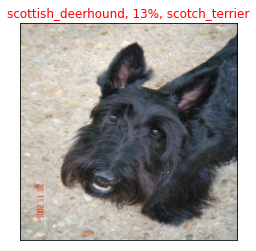

In [ ]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=15)

We do not want the boolean labels here, We need to change the label in our unbatched label to be the actual label

Now we've got one function to visualize our model's top prediction, let's make another to view our models top 10 predictions.
This function will:
* Take an input of prediction probabilities array, the ground truth array and an integer
* Find the prediction using `get_pred_label()`
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels

* Plot the top 10 prediction probability values and labels, coloring the true label green 

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  '''
  Plot the top 10 highest prediction confidences, along with the truth label for sample N
  '''
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort() [-10:] [::-1]

  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]

  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Set up plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                        top_10_pred_values,
                        color='grey')
  plt.xticks(np.arange(len(top_10_pred_labels)),
                    labels=top_10_pred_labels,
                    rotation = 'vertical'
  )
  # Change the color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color('green')
  else:
    pass


### Experimentating with plotting function above

In [ ]:
predictions[0].argsort()

array([ 20,  64,  54,  50,  58, 114,  83,  62,  14,  34,  65, 107,  78,
        15,  12,   1,  82,  51,  22,  91, 117,  28, 108,  18, 112,  23,
        38,  88,  68,  46,  10,  52, 103,  76,  70,  73,  98,   3,  41,
       109,  67,  47,  48,  96,  40,  85, 100,  59, 106, 105,  17,  79,
        71,  69,   2,  31,  30,  66,  44,  35,  94,  95,   0,  25,  61,
        57,  90,  45,  97,  43, 119, 110,  32,  53, 101,  89,  42,  87,
        92,  21, 118,  80, 116,  39,  11,  60,  13,  49, 113,  77,  24,
        16,   8,  33,  72,  36,  93,  75,  56,  19, 102,  81,  74,   6,
        26, 104, 111,  63,   9,   4,   5, 115,  37,  99,   7,  84,  55,
        29,  27,  86])

In [ ]:
predictions[0][predictions[0].argsort()[-10:][::-1]]

array([0.85104686, 0.04000754, 0.02655264, 0.01303928, 0.01298281,
       0.01024763, 0.00532651, 0.00522869, 0.00345032, 0.00308202],
      dtype=float32)

In [ ]:
unique_breeds[predictions[0].argsort()[-10:][::-1]]

array(['pembroke', 'cardigan', 'chihuahua', 'ibizan_hound', 'papillon',
       'basenji', 'shetland_sheepdog', 'dingo', 'welsh_springer_spaniel',
       'appenzeller'], dtype=object)

In [ ]:
predictions[0]

array([8.7279805e-05, 9.5211644e-06, 6.0520233e-05, 3.2188189e-05,
       2.9999774e-03, 3.0820228e-03, 1.2886829e-03, 1.0247625e-02,
       4.1188605e-04, 2.5093243e-03, 2.2738417e-05, 2.6474820e-04,
       8.5928659e-06, 2.7369356e-04, 6.4688702e-06, 8.3473287e-06,
       4.0727400e-04, 4.9173330e-05, 1.7265644e-05, 7.6502596e-04,
       1.9426907e-06, 1.8922001e-04, 1.2012372e-05, 1.9083005e-05,
       3.4607347e-04, 8.9507790e-05, 1.4564659e-03, 4.0007539e-02,
       1.4876295e-05, 2.6552640e-02, 6.4168438e-05, 6.2350489e-05,
       1.3825754e-04, 4.2032651e-04, 7.4920868e-06, 7.2575465e-05,
       4.8331742e-04, 5.2286913e-03, 1.9445155e-05, 2.5615166e-04,
       4.1448711e-05, 3.4930919e-05, 1.6120225e-04, 1.3207128e-04,
       6.9194823e-05, 1.2043912e-04, 2.1710064e-05, 3.8534286e-05,
       3.9872622e-05, 2.7547553e-04, 3.9733368e-06, 1.1698942e-05,
       2.4114117e-05, 1.4239730e-04, 3.8542389e-06, 1.3039276e-02,
       7.0309796e-04, 1.0609170e-04, 4.0195832e-06, 4.6855072e

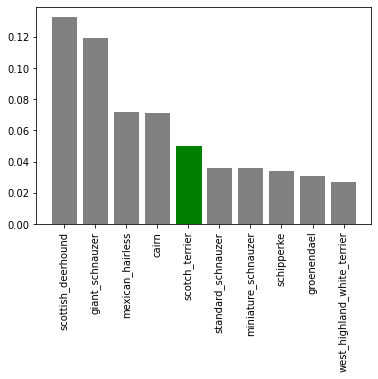

In [ ]:
plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n =15)

Now we've got some functions to help us visualize our predictions and evaluate our model. Let's build out a bigger function

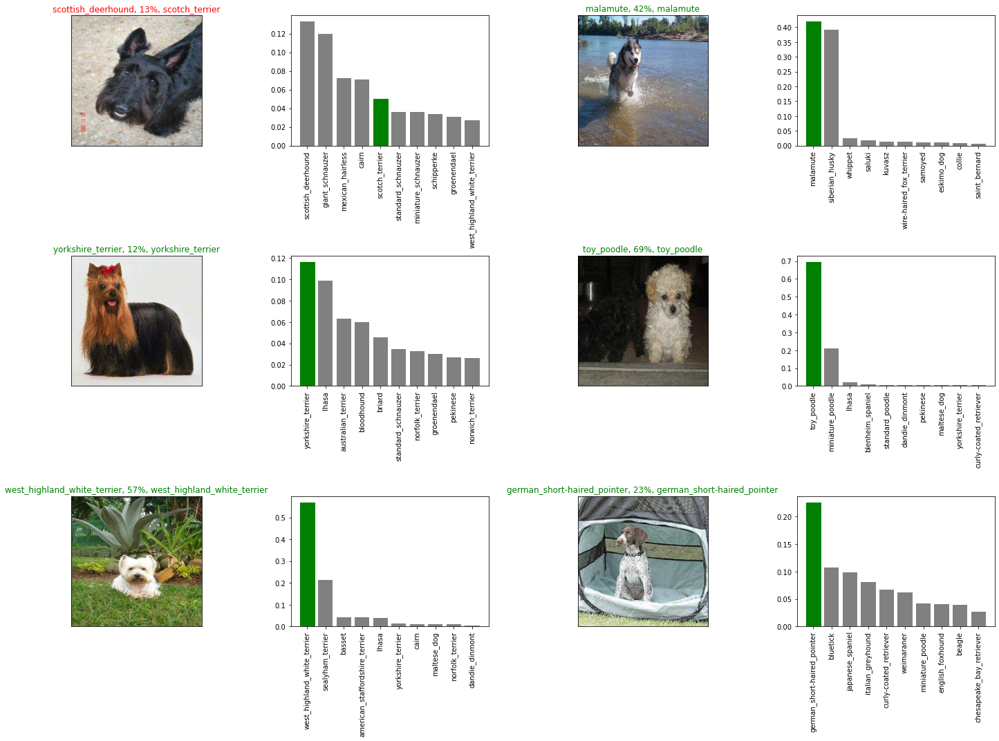

In [ ]:
# Let's check out a few predictions and their different values
i_multiplier = 15
num_rows=3
num_cols=2
num_images = num_cols*num_rows
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)
  plt.tight_layout()

**Challenge:** How would you create a confusion matrix with our model's predictions and true labels?

## Saving and Reloading a trained model

In [ ]:
# Create a function to save our model
def save_model (model, suffix=None):
  '''
  Saves a given model in the model directory and then appends a suffix (string)
  '''
  # Create a model directory pathname with current time
  modeldir = os.path.join('drive/MyDrive/Dog-Vision/dogproj/model(s)',
                          datetime.datetime.now().strftime('%Y%m%d-%H%M%s'))
  model_path = modeldir + '-' + suffix + '.h5' 
  print(f'Saving model to: {model_path}...')
  model.save(model_path)
  return model_path


In [ ]:
# Create a function to load a trained model
def load_model(model_path):
  '''
  Loads a saved model from a specified path
  '''
  print(f'Loading saved model from {model_path}...')
  model = tfl.keras.models.load_model(model_path,
                                      custom_objects={'KerasLayer': tfhub.KerasLayer})
  return model

In [ ]:
# Now we've got functions to save and load a trained model, let's make sure they work!
# Save our model trained on 1000 images
save_model(model, suffix='1000-images-mobilenetV2-Adam')

Saving model to: drive/MyDrive/Dog-Vision/dogproj/model(s)/20210606-20051623009922-1000-images-mobilenetV2-Adam.h5...


'drive/MyDrive/Dog-Vision/dogproj/model(s)/20210606-20051623009922-1000-images-mobilenetV2-Adam.h5'

In [ ]:
# Load a trained model
loaded_1000_image_model = load_model('drive/MyDrive/Dog-Vision/dogproj/model(s)/20210602-21551622670959-1000-images-mobilenetV2-Adam.h5')

Loading saved model from drive/MyDrive/Dog-Vision/dogproj/model(s)/20210602-21551622670959-1000-images-mobilenetV2-Adam.h5...


In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

8/8 [==============================] - 10s 1s/step - loss: 1.3111 - accuracy: 0.6400


[1.3111350536346436, 0.6399999856948853]

In [ ]:
# Evaluate the loaded model
loaded_1000_image_model.evaluate(val_data)

8/8 [==============================] - 10s 1s/step - loss: 1.3332 - accuracy: 0.6280


[1.3332453966140747, 0.628000020980835]

# Training a big dog model 🐶 (on the full data)

In [ ]:
len(x), len(y)

(10222, 10222)

In [ ]:
x[:9]

In [ ]:
len(x_train)

750

In [ ]:
# Create a data batch with the full dataset.
full_data = create_data_batches(x, y)

Create training data batches...


In [ ]:
full_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
# Create a model for full model
full_model = create_model()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [ ]:
# Create full model callbacks
full_model_tsboard = create_tsboard_callback()
# No validation set when training on all the data, so we can't monitor validation accuracy
full_model_early_stopping = tfl.keras.callbacks.EarlyStopping(monitor='accuracy',
                                                              patience=5,
                                                              verbose=2)

**Note** Running the cell below will take a little while (maybe up to 30 minutes fir the first epoch) because the GPU we're using in the runtime has to load all of the images in memory

In [ ]:
# Fit the full model to the full data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tsboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 1355s 4s/step - loss: 1.3473 - accuracy: 0.6659
Epoch 2/100
320/320 [==============================] - 30s 93ms/step - loss: 0.4010 - accuracy: 0.8809
Epoch 3/100
320/320 [==============================] - 30s 93ms/step - loss: 0.2369 - accuracy: 0.9344
Epoch 4/100
320/320 [==============================] - 30s 93ms/step - loss: 0.1538 - accuracy: 0.9609
Epoch 5/100
320/320 [==============================] - 30s 93ms/step - loss: 0.1046 - accuracy: 0.9801
Epoch 6/100
320/320 [==============================] - 30s 93ms/step - loss: 0.0766 - accuracy: 0.9880
Epoch 7/100
320/320 [==============================] - 30s 94ms/step - loss: 0.0587 - accuracy: 0.9916
Epoch 8/100
320/320 [==============================] - 30s 93ms/step - loss: 0.0462 - accuracy: 0.9939
Epoch 9/100
320/320 [==============================] - 30s 93ms/step - loss: 0.0366 - accuracy: 0.9966
Epoch 10/100
320/320 [==============================] - 30s 93ms/step - l

In [ ]:
save_model(full_model, suffix='full-image-set-mobilenetv2-Adam')

Saving model to: drive/MyDrive/Dog-Vision/dogproj/model(s)/20210604-23341622849679-full-image-set-mobilenetv2-Adam.h5...


'drive/MyDrive/Dog-Vision/dogproj/model(s)/20210604-23341622849679-full-image-set-mobilenetv2-Adam.h5'

In [ ]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/Dog-Vision/dogproj/model(s)/20210603-21471622756845-full-image-set-mobilenetv2-Adam.h5')

Loading saved model from drive/MyDrive/Dog-Vision/dogproj/model(s)/20210603-21471622756845-full-image-set-mobilenetv2-Adam.h5...


 ## Making predictions on the test dataset

 Since our model has been trained on images in the form of tensor batches, to make predictions on the test data, we'll have to get it into the same format

 Luckily we created a `create_data_batches` function earlier which can take a list of filenames as input and convert them into Tensor batches

 To mkae predictions on the tests data we'll:
 * Get the test image filenjames
 * Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since the test data doesn't have labels.)
 * Make a prediction array by passing the test batches to the `predict()` method called on our model

In [ ]:
# Load test image filenames
test_path = '/content/drive/MyDrive/Dog-Vision/dogproj/test/'
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['/content/drive/MyDrive/Dog-Vision/dogproj/test/e64d56f012476f124591a22648114a37.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/deaf748bed865ec76758f086db04bfac.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/e48f3d4f0514a07f4777a30f01d32ea9.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/e519e383a6efec0abd285beda04aeac9.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/e265af5e8f446888c6e7ec31f803d63e.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/dd8d95720349f85d2a795adaafc71172.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/e2628b6bde028b5eb593616128728907.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/e6920cc0fd2e3099506d23761d9682e1.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/e683ba5a138de0fbb7bb1523862b43f2.jpg',
 '/content/drive/MyDrive/Dog-Vision/dogproj/test/df577444ba8b7733f42c49e9d42111a9.jpg']

In [ ]:
len(test_filenames)

10357

In [ ]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [ ]:
test_data

<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
# Make predictions on test data batch, using the loaded full model
test_predictions= loaded_full_model.predict(test_data, verbose=1)

324/324 [==============================] - 1455s 5s/step


In [ ]:
# Save predictions (to Numpy array) to csv file (for access later)
np.savetxt('drive/MyDrive/Dog-Vision/dogproj/predic.txt', test_predictions, delimiter=',')

In [ ]:
# Load predictions
test_predictions = np.loadtxt('/content/drive/MyDrive/Dog-Vision/dogproj/predic.txt', delimiter=',')

In [ ]:
test_predictions.shape

(10357, 120)

In [ ]:
test_predictions[0]

array([2.90987602e-15, 9.99968529e-01, 1.03760632e-10, 6.30605568e-10,
       1.59520997e-12, 2.46751166e-12, 2.24886679e-10, 5.06463523e-13,
       7.23326943e-13, 2.11282691e-15, 2.64926405e-12, 5.81429661e-11,
       7.40170217e-11, 2.44035481e-09, 1.97552943e-08, 2.06553885e-10,
       1.84653399e-12, 2.04144807e-13, 6.03899708e-11, 7.66489129e-12,
       2.64025455e-12, 3.43205325e-12, 4.51354550e-15, 3.64902206e-08,
       9.67358346e-11, 2.61245692e-09, 6.76287151e-13, 1.46149992e-13,
       3.75264446e-12, 6.77666256e-13, 2.80634370e-11, 1.13497212e-09,
       6.81027529e-07, 4.21228663e-07, 1.70687507e-13, 7.27541264e-14,
       5.95384753e-15, 3.49872492e-11, 3.00446973e-10, 1.16507000e-08,
       4.71501203e-08, 1.66309273e-12, 7.22502875e-08, 1.86314231e-14,
       7.80679610e-09, 1.78147015e-12, 3.09105057e-14, 2.85418737e-11,
       1.12361855e-13, 8.12215184e-09, 1.24395854e-08, 1.84417526e-09,
       2.43419649e-08, 5.10653152e-12, 2.73410905e-10, 2.46830386e-11,
      

## Put `test_predictions` in the right format for Kaggle

Looking at the Kaggle sample submission, we find that it wants our model's prediction probability outputs in a Dataframe with an ID and a column for each different dog breed
https://www.kaggle.com/c/dog-breed-identification/data?select=sample_submission.csv

To get the data in this format, we'll:
* Create a pandas dataframe with an ID column as well as a column for each dog breed
* Add data (the prediction probabilities) to each of the dog breed columns.
* Export the DataFrame as a CSV to submit it to Kaggle

### My Experimentation

In [ ]:
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
from itertools import islice
# Build lists of probabilities under each breed of dog
def dog_breed_list_builder(setta_breeds):
  '''
  Take the lists of dogs and take their probabilities and puts the right breed with the right probabilities
  '''
  i = 0
  pred = 0
  # Split Lists
  # list of length in which we have to split
  length_to_split = range(1, 110)
  # Using islice
  inputt = iter(unique_breeds)
  output = [list(islice(inputt, elem))
          for elem in length_to_split]
  print(output)



    
  



  
dog_breed_list_builder(unique_breeds)

[['affenpinscher'], ['afghan_hound', 'african_hunting_dog'], ['airedale', 'american_staffordshire_terrier', 'appenzeller'], ['australian_terrier', 'basenji', 'basset', 'beagle'], ['bedlington_terrier', 'bernese_mountain_dog', 'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound'], ['bluetick', 'border_collie', 'border_terrier', 'borzoi', 'boston_bull', 'bouvier_des_flandres'], ['boxer', 'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff', 'cairn', 'cardigan'], ['chesapeake_bay_retriever', 'chihuahua', 'chow', 'clumber', 'cocker_spaniel', 'collie', 'curly-coated_retriever', 'dandie_dinmont'], ['dhole', 'dingo', 'doberman', 'english_foxhound', 'english_setter', 'english_springer', 'entlebucher', 'eskimo_dog', 'flat-coated_retriever'], ['french_bulldog', 'german_shepherd', 'german_short-haired_pointer', 'giant_schnauzer', 'golden_retriever', 'gordon_setter', 'great_dane', 'great_pyrenees', 'greater_swiss_mountain_dog', 'groenendael'], ['ibizan_hound', 'irish_setter', '

In [ ]:
dog_labels

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever
...,...,...
10217,ffd25009d635cfd16e793503ac5edef0,borzoi
10218,ffd3f636f7f379c51ba3648a9ff8254f,dandie_dinmont
10219,ffe2ca6c940cddfee68fa3cc6c63213f,airedale
10220,ffe5f6d8e2bff356e9482a80a6e29aac,miniature_pinscher


In [ ]:
# for val in test_predictions
# data = {'id' : [fname for fname in os.listdir(test_path)],
#         unique_breeds[i] = test}
submission = pd.DataFrame(columns=[breeds for breeds in unique_breeds],
                          index = [fname for fname in os.listdir(test_path)])
submission

,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,english_foxhound,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
e64d56f012476f124591a22648114a37.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
deaf748bed865ec76758f086db04bfac.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
e48f3d4f0514a07f4777a30f01d32ea9.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
e519e383a6efec0abd285beda04aeac9.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
e265af5e8f446888c6e7ec31f803d63e.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
07fecc50840c8da8284ce5dc6552ae8e.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0845cc245f85d15f4bbd847be7d28e8c.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
083969d1802423c9d5b1a9

In [ ]:
for i in range(0,120):
 affenpinscher = [val for val in dict(test_predictions[i][0])]


TypeError: ignored

In [ ]:
list(test_predictions)

[array([2.90987602e-15, 9.99968529e-01, 1.03760632e-10, 6.30605568e-10,
        1.59520997e-12, 2.46751166e-12, 2.24886679e-10, 5.06463523e-13,
        7.23326943e-13, 2.11282691e-15, 2.64926405e-12, 5.81429661e-11,
        7.40170217e-11, 2.44035481e-09, 1.97552943e-08, 2.06553885e-10,
        1.84653399e-12, 2.04144807e-13, 6.03899708e-11, 7.66489129e-12,
        2.64025455e-12, 3.43205325e-12, 4.51354550e-15, 3.64902206e-08,
        9.67358346e-11, 2.61245692e-09, 6.76287151e-13, 1.46149992e-13,
        3.75264446e-12, 6.77666256e-13, 2.80634370e-11, 1.13497212e-09,
        6.81027529e-07, 4.21228663e-07, 1.70687507e-13, 7.27541264e-14,
        5.95384753e-15, 3.49872492e-11, 3.00446973e-10, 1.16507000e-08,
        4.71501203e-08, 1.66309273e-12, 7.22502875e-08, 1.86314231e-14,
        7.80679610e-09, 1.78147015e-12, 3.09105057e-14, 2.85418737e-11,
        1.12361855e-13, 8.12215184e-09, 1.24395854e-08, 1.84417526e-09,
        2.43419649e-08, 5.10653152e-12, 2.73410905e-10, 2.468303

### Ideal way to do it

In [ ]:
# Create a Pandas DataFrame with empty columns
prediction_submission = pd.DataFrame(columns=['id'] + list(unique_breeds))
prediction_submission

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
#Append the test image ID's to predictions DataFrame (This way removes the file extensions as well)
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
test_ids
prediction_submission['id'] = test_ids

In [ ]:
os.path.splitext(test_filenames[0])

In [ ]:
prediction_submission

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e64d56f012476f124591a22648114a37,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,deaf748bed865ec76758f086db04bfac,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e48f3d4f0514a07f4777a30f01d32ea9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e519e383a6efec0abd285beda04aeac9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e265af5e8f446888c6e7ec31f803d63e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10352,07fecc50840c8da8284ce5dc6552ae8e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10353,0845cc245f85d15f4bbd847be7d28e8c,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10354,083969d1802423c9d5b1a9f1bb613b67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [ ]:
# Add the prediction probabilities to each dog breed columns
prediction_submission[list(unique_breeds)] = test_predictions
prediction_submission.head()


,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e64d56f012476f124591a22648114a37,2.90988e-15,0.999969,1.03761e-10,6.30606e-10,1.59521e-12,2.46751e-12,2.24887e-10,5.06464e-13,7.23327e-13,2.11283e-15,2.64926e-12,5.8143e-11,7.4017e-11,2.44035e-09,1.97553e-08,2.06554e-10,1.84653e-12,2.04145e-13,6.039e-11,7.66489e-12,2.64025e-12,3.43205e-12,4.51355e-15,3.64902e-08,9.67358e-11,2.61246e-09,6.76287e-13,1.4615e-13,3.75264e-12,6.77666e-13,2.80634e-11,1.13497e-09,6.81028e-07,4.21229e-07,1.70688e-13,7.27541e-14,5.95385e-15,3.49872e-11,3.00447e-10,...,2.29214e-14,1.71151e-12,1.37183e-10,1.78203e-09,4.90602e-11,6.28399e-09,1.6763e-12,5.25744e-12,3.09038e-15,8.64841e-12,1.15622e-07,1.76568e-09,9.40956e-12,5.593e-07,5.10925e-15,2.62229e-11,2.41074e-12,1.63754e-07,1.25702e-11,9.89958e-12,2.64673e-07,1.69528e-12,2.20661e-05,1.03021e-11,6.01406e-12,1.36616e-10,9.99954e-11,3.85827e-06,2.95022e-09,6.2679e-09,3.40665e-11,6.94157e-14,4.32829e-10,1.03265e-11,1.58938e-09,1.89708e-11,3.08723e-14,3.06986e-10,2.32864e-13,9.54502e-10
1,deaf748bed865ec76758f086db04bfac,9.87491e-09,9.3633e-08,1.45767e-06,5.43942e-11,6.12345e-18,5.24388e-16,3.59157e-10,1.28148e-09,2.63501e-10,3.86678e-16,7.36752e-11,3.19211e-12,7.73456e-11,3.89476e-11,1.89593e-11,3.27812e-12,7.12989e-13,7.48713e-08,1.18086e-09,4.88339e-12,4.3491e-07,1.87e-07,1.30978e-11,1.80759e-08,2.25344e-11,1.56448e-10,1.65103e-08,6.16447e-06,4.94441e-08,6.92571e-11,1.67335e-10,9.3626e-13,6.26614e-13,2.02827e-12,1.2337e-09,1.79412e-09,3.03365e-08,4.64341e-07,7.54555e-09,...,0.558364,4.06904e-10,3.01682e-13,1.24269e-12,2.85012e-11,5.76422e-11,3.4593e-12,1.21398e-11,3.71077e-10,5.91208e-11,3.60545e-13,6.91542e-16,2.0192e-13,3.381e-15,7.98421e-11,1.4744e-09,2.48027e-07,5.26047e-11,2.34898e-13,1.20798e-09,2.8542e-13,1.55613e-08,5.19564e-12,1.62293e-10,2.11114e-06,2.14723e-07,1.40493e-06,2.39386e-10,1.58437e-09,4.03729e-09,8.12871e-14,2.55446e-11,5.98915e-12,8.53382e-12,4.18657e-13,1.41797e-16,4.53153e-14,2.63359e-11,2.25603e-10,3.65738e-12
2,e48f3d4f0514a07f4777a30f01d32ea9,8.76426e-07,3.43546e-12,1.10831e-14,2.1934e-10,2.60543e-11,5.94848e-12,1.83619e-13,3.26915e-14,3.39449e-11,4.18776e-16,8.7931e-12,4.30453e-16,2.79173e-10,1.55228e-13,6.85333e-10,7.24181e-14,2.73499e-10,2.14805e-12,2.04888e-11,4.12076e-11,2.919e-11,5.80062e-14,3.64414e-08,1.90792e-11,5.58601e-13,9.61014e-09,1.47439e-15,3.16881e-12,2.01822e-07,7.23704e-14,8.39827e-10,1.12005e-14,2.12349e-12,3.3451e-07,4.44861e-06,8.87877e-14,5.86679e-08,6.31917e-11,5.90234e-08,...,7.99314e-10,4.04919e-12,3.2604e-15,2.25182e-12,2.63271e-11,3.75128e-13,1.53383e-12,4.54241e-12,3.65985e-08,1.13578e-06,5.73711e-14,2.75235e-13,6.63378e-10,2.49267e-12,1.49052e-13,6.5796e-06,1.15479e-09,2.83404e-08,5.72147e-12,1.12893e-13,2.79258e-09,4.00262e-08,6.71447e-15,8.25473e-09,1.93122e-08,2.49043e-07,2.87798e-11,4.75638e-07,2.28894e-08,2.90616e-13,8.73977e-14,1.50586e-15,0.000171566,3.67291e-11,1.871e-11,1.46991e-14,2.54038e-12,2.2

In [ ]:
# Save our predictions dataframe to CSV for submission to Kaggle
prediction_submission.to_csv('drive/MyDrive/Dog-Vision/dogproj/full_model_prediction_submission_2_mobilenetV2.csv', index=False)

## Making predictions on custom images

To make predictions on custom images, we'll:
* Get the filepaths of our own images.
* Turn the filepaths into data batches using `create_data_batches()` and since our custom images wont have labels, we'll set `test_data` parameter to `True`'
* Pass the custom image data batch to our model's `predict()` method.
* Convert the prediction output probabilities to predictions labels.
* Compare the predicted labels to the custom images

In [ ]:
# Get custom image filepaths
custom_path = 'drive/MyDrive/Dog-Vision/dogproj/custom-dog-images/'
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]
custom_image_paths

['drive/MyDrive/Dog-Vision/dogproj/custom-dog-images/Cool-Dog-Breeds-And-Mighty-Mixes-LS-long.jpg',
 'drive/MyDrive/Dog-Vision/dogproj/custom-dog-images/download.jpg',
 'drive/MyDrive/Dog-Vision/dogproj/custom-dog-images/db8f55655cade57dcde44d1791c427d2.jpg',
 'drive/MyDrive/Dog-Vision/dogproj/custom-dog-images/heroimage0.604607001522690565-1024x675.jpg',
 'drive/MyDrive/Dog-Vision/dogproj/custom-dog-images/shutterstock_494351797-1024x683.jpg']

In [ ]:
# Turn custom images into a batch dataset
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches...


<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
# Make predictions of the custom data
custom_preds = loaded_full_model.predict(custom_data)
custom_preds

array([[1.59037183e-09, 1.31964502e-12, 7.11791358e-07, 1.51340052e-10,
        3.38754262e-07, 3.20528422e-08, 1.05676685e-04, 3.00327827e-07,
        3.55017800e-13, 6.70997286e-12, 2.17249038e-10, 7.41561591e-15,
        3.02426334e-10, 6.79192791e-09, 2.25978369e-09, 9.61349656e-07,
        1.28146581e-07, 7.41182475e-08, 8.92530494e-08, 1.26421810e-07,
        2.36922597e-06, 1.15994027e-07, 1.67402959e-07, 3.65753391e-12,
        4.43251325e-14, 4.43889960e-11, 9.98034502e-11, 3.56567180e-05,
        1.67842873e-09, 4.82274265e-09, 1.37289469e-08, 3.43530564e-12,
        9.22768285e-12, 6.06390245e-07, 3.58088864e-10, 1.68363396e-11,
        1.42036001e-08, 1.43210627e-06, 3.44479723e-10, 5.27089753e-07,
        1.49630447e-11, 2.42627880e-11, 2.70548202e-14, 1.44924767e-11,
        2.70789363e-10, 1.42085048e-06, 8.19736545e-09, 1.32490939e-07,
        3.93297922e-10, 2.31320962e-09, 1.70530159e-10, 3.28374691e-02,
        4.28417879e-09, 1.76595208e-07, 2.60931166e-10, 1.787449

In [ ]:
custom_preds.shape

(5, 120)

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['malinois',
 'staffordshire_bullterrier',
 'tibetan_mastiff',
 'great_pyrenees',
 'siberian_husky']

In [ ]:
# Get custom images (our unbatchify function won't work since there aren't labels..maybe we could fix this later)
custom_images = []

# loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

# custom_images


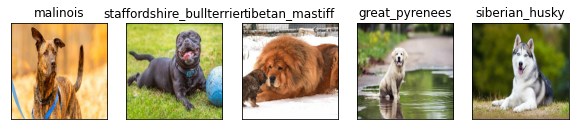

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 5, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)